# Setup

## Imports and Configuration

In [3]:
%load_ext autoreload
%autoreload 2

import os
import re
import json
from datetime import datetime
import functools
import matplotlib.pyplot as plt
import seaborn as sb
from anndata import AnnData
import scanpy as sc
import pandas as pd
import numpy as np
import corescpy as cr

pd.options.display.max_columns = 100
pd.options.display.max_rows = 200
sc.settings.set_figure_params(dpi=100, frameon=False, figsize=(20, 20))

palette = "tab20"


def construct_file(sample, slide, date=None, timestamp=None,
                   panel_id="TUQ97N", prefix="output-XETG00189",
                   project_owner="EA", run="CHO-001", directory=None):
    """Construct file path from information."""
    if isinstance(sample, str):
        sample = [sample]
    if "outputs" not in directory and os.path.exists(
            os.path.join(directory, "outputs")):
        directory = os.path.join(directory, "outputs")
    print(directory)
    panel_id, prefix, project_owner, slide, date, timestamp = [
        [x] * len(sample) if isinstance(x, str) else list(x) if x else x
        for x in [panel_id, prefix, project_owner, slide, date, timestamp]]
    run = [run] * len(sample) if isinstance(run, (str, int, float)) else run
    block = ["-".join(i) for i in zip(sample, panel_id, project_owner)]
    fff = [f"{prefix[i]}__{slide[i]}__{block[i]}" for i in range(len(sample))]
    if date is None or timestamp is None:
        for i, x in enumerate(fff):  # iterate current file stems
            ddd = os.path.join(directory, panel_id[i], run[i])
            print(ddd)
            matches = sum([x in d for d in os.listdir(ddd)])
            if  matches != 1:
                raise ValueError(f"{x} found in 0 or multiple file paths",
                                 f"\n\n{os.listdir(ddd)}")
            fff[i] = os.path.join(ddd, np.array(os.listdir(ddd))[np.where([
                x in d for d in os.listdir(ddd)])[0][0]])  # find match
    else:
        fff = [os.path.join(directory, panel_id[i], run[i],
                            f"{x}__{date[i]}__{timestamp[i]}")
               for i, x in enumerate(fff)]
    return fff

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Options

In [5]:
# Column Names
col_sample_id_original = "Sample ID"
col_sample_id = "Sample"
col_subject = "Patient"
col_batch = "Slide"
col_path = "file_path"
# col_date_time, col_date = "Date Sectioned", "Date"
col_date_time, col_date = None, None
col_inflamed, col_stricture = "Inflamed", "Stricture"
col_condition = "Condition"
meta_rn = {"Name": col_subject, "Slide ID": col_batch,
           "Inflammation Status": col_inflamed}

# Directories & Metadata
# Replace manually or mirror my file/directory tree in your home
include_stricture = True
run = "CHO-001"
# samples = ["50452A", "50452B", "50452C"]
samples = ["50452A", "50452B", "50452C"]
# samples = ["50452A", "50452B", "50452C", "50564A4", "50618B5"]
# run = ["CHO-001"] * 3 + ["CHO-002"] * 3
panel_id = "TUQ97N"
prefix = "output-XETG00189"
project_owner = "EA"
ddu = os.path.expanduser("~")
ddl = "/mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library"
ddd = os.path.join(ddl, "outputs", panel_id)
panel = os.path.join(ddu, "projects/senescence/ProposedGenePanel.xlsx")
file_ann = os.path.join(ddu, "corescpy/examples/annotation_guide.xlsx")

# Input/Output Options
reload = True
out_dir = os.path.join(ddd, "nebraska")  # set to None to avoid saving
if not os.path.exists(out_dir):
    os.makedirs(out_dir)

# Computing Resources
gpu = False
sc.settings.n_jobs = 4
sc.settings.max_memory = 100

# Read Metadata & Other Information
annot_df = pd.read_excel(file_ann)
metadata = pd.read_excel(os.path.join(ddl, "Xenium_Samples_02092024.xlsx"),
                         dtype={"Slide ID": str})
metadata = metadata.rename(meta_rn, axis=1)
if samples not in ["all", None]:  # subset by sample ID?
    metadata = metadata.set_index(col_sample_id_original).loc[
        samples].reset_index()

# Processing & Clustering Options
resolution = 0.75
min_dist = 0.8
n_comps = 50
# col_qscore = ?
# custom_thresholds = {col_qscore: [, None]}
custom_thresholds = None
genes_subset = list(annot_df.iloc[:, 0])
kws_pp = dict(cell_filter_pmt=None, cell_filter_ncounts=[50, None],
              cell_filter_ngene=[30, None], gene_filter_ncell=[3, None],
              gene_filter_ncounts=[3, None],
              custom_thresholds=custom_thresholds,
              kws_scale=dict(max_value=10, zero_center=True))
kws_umap = dict(min_dist=min_dist, method="rapids") if gpu is True else dict(
    min_dist=min_dist)
kws_cluster = dict(use_gpu=gpu, kws_umap=kws_umap, kws_neighbors=None,
                   use_highly_variable=False, n_comps=n_comps,
                   genes_subset=genes_subset, resolution=resolution)
kws_subcluster = dict(use_gpu=gpu, kws_umap=dict(min_dist=0.3),
                      kws_neighbors=None, use_highly_variable=False,
                      n_comps=n_comps, genes_subset=genes_subset,
                      resolution=0.5)
cell_types = None
genes = ["CDKN1A", "CDKN2A", "TP53", "PLAUR", "PTGER4", "FTL", "IL6ST",
         "CSF2RB", "CSF2RA", "IL7R", "TBX21", "KLRB1", "CCL5", "HSP90AA1",
         "RORC", "IL23R", "KIT", "CCL20", "TCF7", "LTB", "IL22", "IFNG",
         "PDGFRA", "PTPN1", "OSM", "IL13", "IL1B", "IL6", "TNF", "S100A8",
         "S100A9", "NOD2", "LACC1", "LRRK2"]

# Revise Metadata & Construct Variables from Options
if col_stricture not in metadata.columns:
    metadata.loc[:, col_stricture] = metadata["Sample Location"].apply(
        lambda x: "Stricture" if "stricture" in x.lower() else "None")
metadata.loc[:, col_condition] = metadata.apply(
    lambda x: "Stricture" if "stricture" in x[col_stricture].lower() else x[
        col_inflamed].capitalize() , axis=1)
if col_date_time:
    metadata.loc[:, col_date] = metadata[col_date_time].apply(
        lambda x: datetime.strftime(x, "%Y%m%d"))
    dates = list(metadata[col_date])
else:
    dates = None
metadata.loc[:, col_sample_id] = metadata.apply(
    lambda x: f"{x[col_condition]}-{x[col_sample_id_original]}" , axis=1)
metadata = metadata.set_index(col_sample_id)
metadata.loc[:, col_path] = construct_file(
    list(metadata[col_sample_id_original]), list(metadata[col_batch]),
    dates, panel_id=panel_id, prefix=prefix,
    project_owner=project_owner, run=run, directory=ddl)
col_cell_type = "Annotation"
file_path_dict = dict(zip(metadata.index.values, metadata["file_path"]))
kws_init = dict(col_batch=col_batch, col_subject=col_subject,
                col_sample_id=col_sample_id, col_cell_type=col_cell_type)

# Annotation File
col_assignment = "Type"
assign = pd.read_excel(file_ann, index_col=0)
sources = assign[col_assignment].unique()
rename = dict(zip(sources, [" ".join([i.capitalize() if i and i[
    0] != "(" and not i.isupper() and i not in [
        "IgG", "IgA"] else i for i in x.split(" ")]) if len(x.split(
            " ")) > 1 else x for x in [re.sub("glia", "Glia", re.sub(
                "_", " ", j)) for j in sources]]))
assign.loc[:, col_assignment] = assign[col_assignment].replace(rename)
assign = assign.rename_axis("Gene")
assign.columns = [col_assignment]
marker_genes_dict = dict(assign.reset_index().groupby(col_assignment).apply(
    lambda x: list(pd.unique(x.Gene))))  # to marker dictionary

# Subset if Desired
if include_stricture is False:
    metadata = metadata[metadata.Stricture != "Stricture"]
metadata

# Genes
# genes = ["CDKN1A", "CDKN2A", "TP53", "PLAUR", "PTGER4", "FTL", "IL6ST"]
# cell_types = ["ILC3", "LTi-like NCR+ ILC3", "LTi-like NCR- ILC3",
#               "ILCP", "Macrophages", "Stem cells"]
# palette = ["r", "tab:pink", "m", "b", "tab:brown", "cyan"]
# High in inf. vs. un
# OSM
# IL13
# IL1B
# IL6
# TNF
# S100A8
# S100A9
# ------------------------------
# High in stricture vs inf/un
# PDGFRA
# IL6ST
# PTPN1
# IFNG

/mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library/outputs
/mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library/outputs/TUQ97N/CHO-001
/mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library/outputs/TUQ97N/CHO-001
/mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library/outputs/TUQ97N/CHO-001


,Sample ID,Patient,Status,Project,Sample Location,Inflamed,Slide,GRID ID,Procedure Date,Age,Sex,Race,Hispanic,Diagnosis,Project.1,Procedure,Disease Status,Date Collected,Date Sectioned,Date of Hybridization,Storage in 4C,Created By,Created,Storage Status,Sample Location.1,Storage Row,Storage Col,Checked Out By,Stricture,Condition,file_path
Sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,NaN,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887,Not in storage,NaN,NaN,NaN,NaN,None,Uninflamed,/mnt/cho_lab/disk2/elizabeth/data/shared-xeniu...
Inflamed-50452B,50452B,50452,Available,scRNA & Spatial,Terminal Ileum,inflamed,0010700,1011335,2023-12-04,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,NaN,2024-01-22 00:00:00,2024-01-23 00:00:00,YES,ksenija sabic,2024-02-06 15:26:47.887,Not in storage,NaN,NaN,NaN,NaN,None,Inflamed,/mnt/cho_lab/disk2/elizabeth/data/shared-xeniu...
Stricture-50452C,50452C,50452,Available,scRNA & Spatial,Terminal Ileum (stricture),inflamed,0010663,1011335,2023-12-04,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,NaN,2024-01-22 00:00:00,2024-01-23 00:00:00,YES,ksenija sabic,2024-02-06 15:26:47.887,Not in storage,NaN,NaN,NaN,NaN,Stricture,Stricture,/mnt/cho_lab/disk2/elizabeth/data/shared-xeniu...


## Re-Name Files in Standard Form Using Object

In [ ]:
# fff = list(pd.Series([x if "h5ad" in x else np.nan for x in os.listdir(
#     out_dir)]).dropna())
# frn = []
# for x in fff:
#     ann = sc.read(os.path.join(out_dir, x))
#     kwu = re.sub("{", "", re.sub("}", "", str(ann.obs.iloc[0].kws_umap))
#                  ).split(", ")
#     kwu = np.array(kwu)[np.where(["min_dist" in x for x in kwu])[
#         0]][0].split(": ")[1]
#     frn += [str(f"{str(ann.obs.iloc[0][col_sample_id])}__"
#                 f"res{str(ann.obs.iloc[0].resolution)}"
#                 f"_dist{kwu}_npc{ann.varm['PCs'].shape[1]}")]
# frd = dict(zip([os.path.join(out_dir, i) for i in fff], [os.path.join(
#     out_dir, re.sub("[.]", "pt", re.sub("[.]h5ad", "", i)) + ".h5ad")
#                                                          for i in frn]))
# frd
# # for x in frd:
# #     os.system(f"mv {x} {frd[x]}")

# Data

## Loading

In [6]:
%%time

# Load Spatial Data
suff = str(f"res{re.sub('[.]', 'pt', str(resolution))}_dist"
           f"{re.sub('[.]', 'pt', str(min_dist))}_npc{n_comps}")  # file end
selves, paths_he, file_mks, out_files = [], [], [], []
for x in metadata.index.values:
    self = cr.Spatial(metadata.loc[x][col_path], library_id=x, **kws_init)
    for i in metadata:  # add metadata for subject
        self.rna.obs.loc[:, i] = str(metadata.loc[x][i])  # add metadata
    selves += [self]
    paths_he += [os.path.join(metadata.loc[x][
        col_path], "aux_outputs/image_he.tif")]  # H&E paths
        # out_files += [os.path.join(out_dir, f"{x}.zarr")]
    if out_dir is not None:
        out_files += [os.path.join(out_dir, f"{x}__{suff}.zarr")]
    file_mks += [os.path.join(out_dir, f"{x}__{suff}_markers.csv")]

# Reload Processed & Clustered Data (Optionally)
if reload is True:
    for i, s in enumerate(selves):
        mks = file_mks[i] if os.path.exists(file_mks[i]) else None
        s.update_from_h5ad(file=out_files[i], file_path_markers=mks)



<<< INITIALIZING SPATIAL CLASS OBJECT >>>



<<< INITIALIZING OMICS CLASS OBJECT >>>

Unused keyword arguments: {'library_id': 'Uninflamed-50452A', 'visium': False}.




col_gene_symbols="gene_symbols"
col_cell_type="Annotation"
col_sample_id="Sample"
col_batch="Slide"
col_subject="Patient"
col_condition=None
col_num_umis=None



key_control=None
key_treatment=None
INFO     reading                                                                                                   
         /mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library/outputs/TUQ97N/CHO-001/output-XETG00189__0010700__
         50452A-TUQ97N-EA__20240126__205019/cell_feature_matrix.h5                                                 
dsfasfda AnnData object with n_obs × n_vars = 333825 × 469
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'Sample'
    var

## Update from Saved h5ad?

In [7]:
# Reload Objects
if reload is True:
    for i, s in enumerate(selves):
        mks = file_mks[i] if os.path.exists(file_mks[i]) else None
        s.update_from_h5ad(file=out_files[i], file_path_markers=mks)

# Save Annotations for Xenium Explorer Upload
# for i, s in enumerate(selves):
#     # _ = s.annotate_clusters(file_ann, col_cell_type="leiden",
#     #                         col_annotation=col_cell_type,
#     #                         out_file=out_files[i])  # annotate & write
#     s.rna.obs.set_index("cell_id")[col_cell_type].to_frame("group").to_csv(
#         os.path.splitext(out_files[i])[0] + "_annotations.csv")
#     s.rna.obs.set_index("cell_id")["leiden"].to_frame("group").to_csv(
#         os.path.splitext(out_files[i])[0] + "_leiden.csv")



<<< RESTORING SINGLE-SAMPLE FROM h5ad >>>



<<< RESTORING SINGLE-SAMPLE FROM h5ad >>>



<<< RESTORING SINGLE-SAMPLE FROM h5ad >>>



In [ ]:
for i, s in enumerate(selves):
    s.plot_spatial(color=list(pd.unique(["leiden", col_cell_type])))

# Sub-Clustering

In [9]:
out_files

['/mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library/outputs/TUQ97N/nebraska/Uninflamed-50452A__res0pt75_dist0pt8_npc50.zarr',
 '/mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library/outputs/TUQ97N/nebraska/Inflamed-50452B__res0pt75_dist0pt8_npc50.zarr',
 '/mnt/cho_lab/disk2/elizabeth/data/shared-xenium-library/outputs/TUQ97N/nebraska/Stricture-50452C__res0pt75_dist0pt8_npc50.zarr']

In [11]:
marker_genes_dict

{'Activated CD4 T': ['GPR183',
  'SOCS3',
  'TNFSF8',
  'CH25H',
  'SC5D',
  'FAAH2',
  'CMTM8'],
 'Adult Glia': ['SPARCL1',
  'IGFBP7',
  'MT2A',
  'S100A4',
  'CLU',
  'SCN7A',
  'MT1E',
  'GPR155',
  'HLA-B',
  'NRN1',
  'SPP1',
  'NEAT1',
  'LGI4',
  'SELENOM',
  'MYOT',
  'S100A6',
  'TXNIP',
  'HLA-C',
  'MT1M',
  'PRNP',
  'FXYD1',
  'CD74',
  'SORBS2',
  'IFI27',
  'CLIC4',
  'PDK4',
  'NNMT',
  'NUPR1',
  'HLA-E',
  'GBP2',
  'CST3',
  'SAMHD1',
  'HLA-DRB1',
  'CAB39L',
  'ANK3',
  'DOCK5',
  'HLA-A',
  'C2orf88',
  'ASPH',
  'MT1X',
  'IFI35',
  'SERPING1',
  'HLA-DRA',
  'IGHA1',
  'EPB41L2',
  'ITGB4',
  'ZFP36',
  'RARRES3',
  'ASPA',
  'GPX3'],
 'Angiogenic Pericyte': ['OLFML2B',
  'PELO',
  'ENPEP',
  'GNAI1',
  'EGFL6',
  'C1orf198',
  'ABCC8',
  'LASP1',
  'SYTL2',
  'KCNJ8',
  'FAM162B',
  'COL4A1',
  'DLC1',
  'GUCY1A2',
  'SEMA5B',
  'KHDRBS3',
  'RAP2A',
  'COL25A1',
  'COL4A2',
  'AC018647.1',
  '7-Sep',
  'INPP4B',
  'TRPC6',
  'TEX41',
  'ACAN',
  'LINC00989',


In [13]:
ann.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,Sample,Sample ID,Patient,Status,Project,Sample Location,Inflamed,Slide,GRID ID,Procedure Date,Age,Sex,Race,Hispanic,Diagnosis,Project.1,Procedure,Disease Status,Date Collected,Date Sectioned,Date of Hybridization,Storage in 4C,Created By,Created,Storage Status,Sample Location.1,Storage Row,Storage Col,Checked Out By,Stricture,Condition,file_path,n_counts,log_counts,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,log1p_total_counts,assay_protein,col_gene_symbols,col_cell_type,col_sample_id,col_batch,col_subject,col_condition,col_num_umis,col_segment,cell_filter_pmt,cell_filter_ncounts,cell_filter_ngene,gene_filter_ncell,gene_filter_ncounts,custom_thresholds,figsize,kws_scale,method_cluster,leiden,kws_pca,kws_umap,kws_neighbors,kws_cluster,resolution,genes_subset,Annotation,leiden_subcluster,Sub-Clustering
0,aaaaibki-1,168,0,0,0,0,168.0,328.150481,13.908126,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,168.0,5.123964,93,93,4.543295,5.129899,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,22,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",SMC (PLPP2+),22,NaN
1,aaaaiiji-1,166,0,0,0,0,166.0,107.607348,18.649532,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,166.0,5.111988,94,94,4.553877,5.117994,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,6,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",Macrophages_NK Cell,6,NaN
2,aaaajape-1,135,0,0,0,0,135.0,110.226410,10.250469,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,135.0,4.905275,77,77,4.356709,4.912655,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,4,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",Angiogenic Pericyte,4,NaN
3,aaaamhbm-1,99,0,0,0,0,99.0,46.736720,16.482032,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,99.0,4.595120,68,68,4.234107,4.605170,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,10,"{'n_comps': None, 'use_



Un-used Keyword Arguments: {'assay': None, 'col_gene_symbols': 'gene_symbols', 'col_cell_type': 'Annotation', 'col_sample_id': 'Sample', 'col_batch': 'Slide', 'col_subject': 'Patient', 'col_condition': None, 'col_num_umis': None, 'col_segment': 'region', 'key_control': None, 'key_treatment': None}


<<< PERFORMING PCA >>>
{'use_highly_variable': False, 'n_comps': 50, 'random_state': 0}



<<< COMPUTING NEIGHBORHOOD GRAPH >>>
{'random_state': 0, 'n_pcs': 50}



<<< EMBEDDING UMAP >>>
{'random_state': 0, 'min_dist': 0.3}



<<< CLUSTERING WITH LEIDEN METHOD >>>


<<< CREATING PLOTS >>>


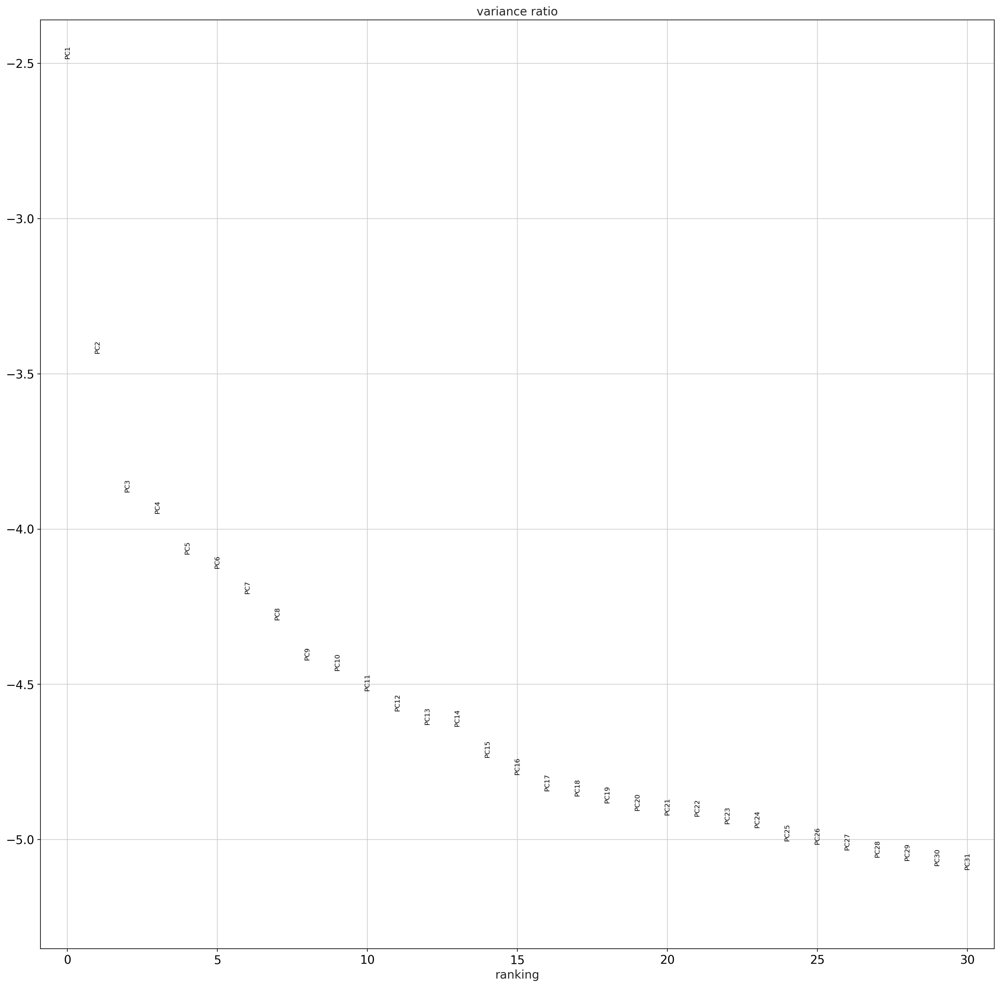

<Figure size 2000x2000 with 0 Axes>

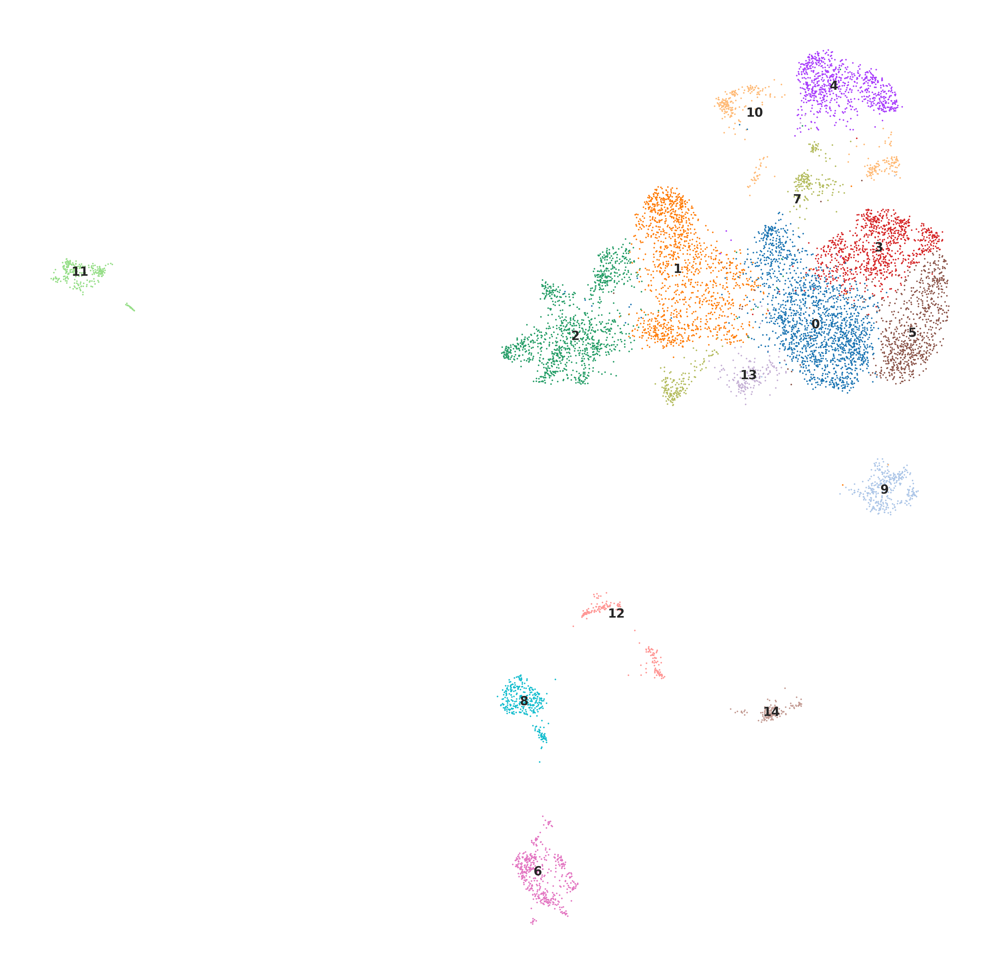

... storing 'kws_pca' as categorical
... storing 'kws_umap' as categorical
... storing 'kws_neighbors' as categorical
... storing 'resolution' as categorical
... storing 'genes_subset' as categorical
... storing 'leiden_subcluster' as categorical
... storing 'Sub-Clustering' as categorical


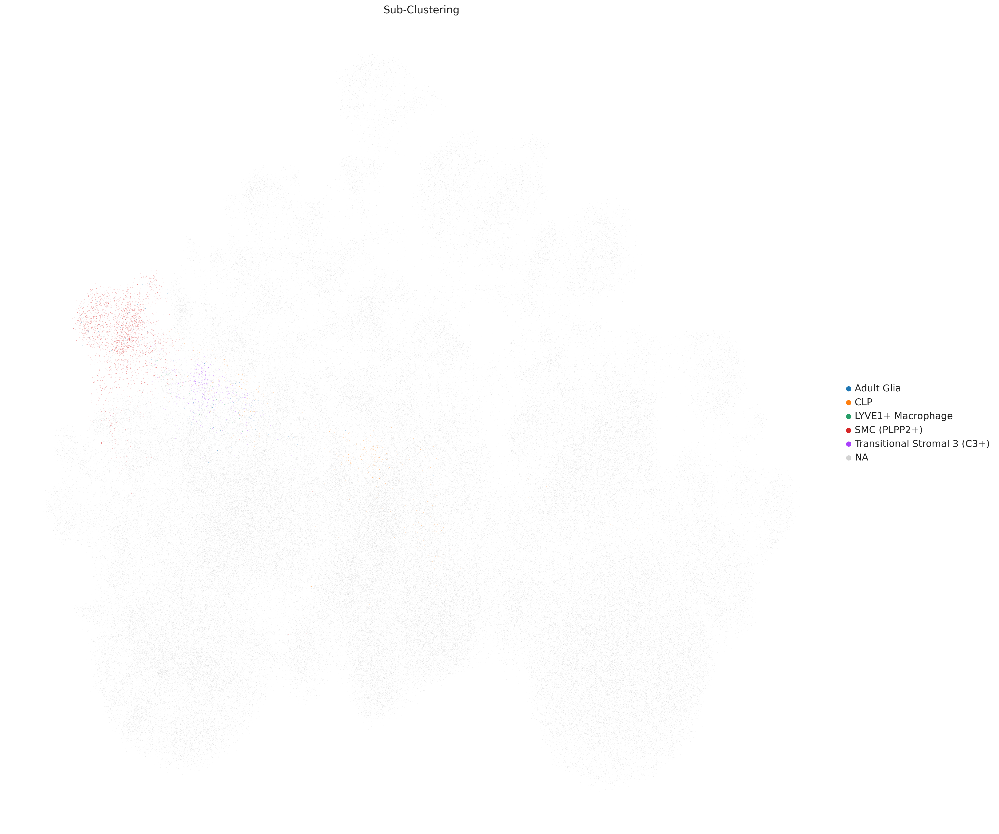

In [14]:
i = 0
s = selves[i]
key_cell_type = ["7"]
ann = s.subcluster(key_cell_type=key_cell_type, copy=False,
                   kws_annotation=file_ann, col_cell_type="leiden",
                   col_annotation="Sub-Clustering", **kws_subcluster)

In [17]:
s.rna.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,Sample,Sample ID,Patient,Status,Project,Sample Location,Inflamed,Slide,GRID ID,Procedure Date,Age,Sex,Race,Hispanic,Diagnosis,Project.1,Procedure,Disease Status,Date Collected,Date Sectioned,Date of Hybridization,Storage in 4C,Created By,Created,Storage Status,Sample Location.1,Storage Row,Storage Col,Checked Out By,Stricture,Condition,file_path,n_counts,log_counts,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,log1p_total_counts,assay_protein,col_gene_symbols,col_cell_type,col_sample_id,col_batch,col_subject,col_condition,col_num_umis,col_segment,cell_filter_pmt,cell_filter_ncounts,cell_filter_ngene,gene_filter_ncell,gene_filter_ncounts,custom_thresholds,figsize,kws_scale,method_cluster,leiden,kws_pca,kws_umap,kws_neighbors,kws_cluster,resolution,genes_subset,Annotation,leiden_subcluster
0,aaaaibki-1,168,0,0,0,0,168.0,328.150481,13.908126,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,168.0,5.123964,93,93,4.543295,5.129899,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,22,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",SMC (PLPP2+),22
1,aaaaiiji-1,166,0,0,0,0,166.0,107.607348,18.649532,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,166.0,5.111988,94,94,4.553877,5.117994,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,6,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",Macrophages_NK Cell,6
2,aaaajape-1,135,0,0,0,0,135.0,110.226410,10.250469,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,135.0,4.905275,77,77,4.356709,4.912655,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,4,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",Angiogenic Pericyte,4
3,aaaamhbm-1,99,0,0,0,0,99.0,46.736720,16.482032,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,99.0,4.595120,68,68,4.234107,4.605170,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,10,"{'n_comps': None, 'use_highly_variable': False}",{

👉 Detailed model information can be found at `https://www.celltypist.org/models`


    Activated CD4 T  Adult Glia  Angiogenic Pericyte  B (Plasma RBC)  B Cell  \
0               0.0         0.0                  0.0             0.0     0.0   
1               0.0         0.0                  0.0             0.0     1.0   
2               0.0         0.0                  2.0             0.0     0.0   
3               0.0         0.0                  0.0             4.0     0.0   
4               0.0         3.0                  3.0             0.0     0.0   
5               0.0         1.0                  1.0             0.0     0.0   
6               0.0         0.0                  0.0             0.0     0.0   
7               0.0         1.0                  2.0             0.0     0.0   
8               0.0         2.0                  2.0             0.0     0.0   
9               0.0         0.0                  0.0             0.0     0.0   
10              0.0         2.0                  2.0             0.0     0.0   
11              0.0         0.0         

... storing 'Annotation' as categorical


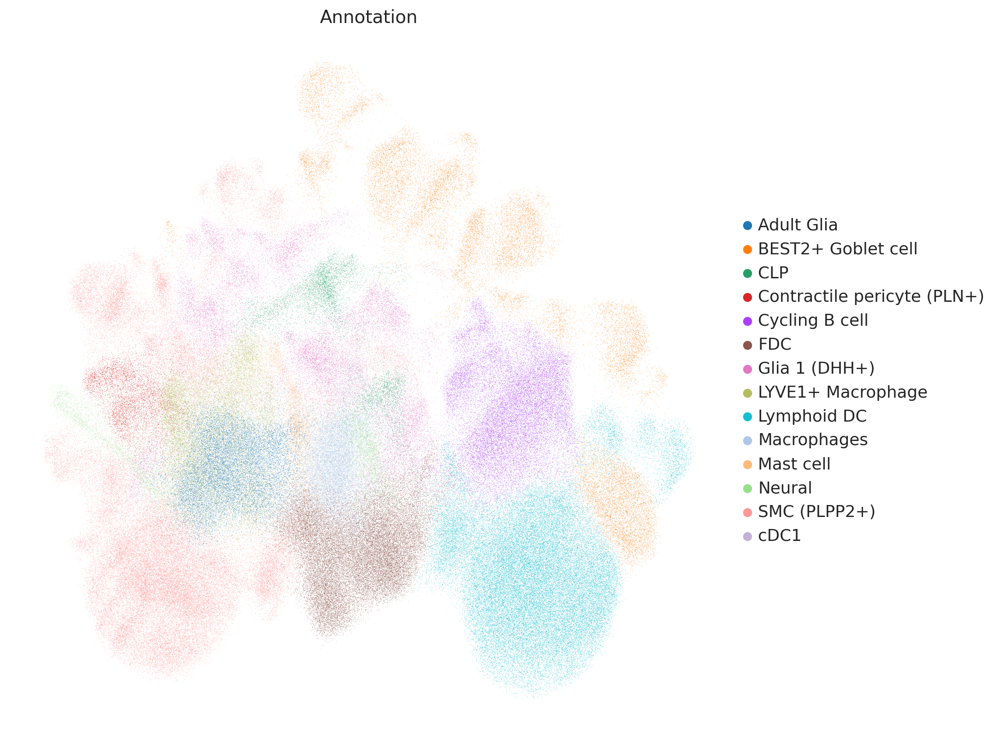

👉 Detailed model information can be found at `https://www.celltypist.org/models`


    Activated CD4 T  Adult Glia  Angiogenic Pericyte  B (Plasma RBC)  B Cell  \
0               0.0         0.0                  0.0             0.0     0.0   
1               0.0         0.0                  0.0             0.0     1.0   
2               0.0         0.0                  2.0             0.0     0.0   
3               0.0         0.0                  0.0             5.0     0.0   
4               0.0         2.0                  3.0             0.0     0.0   
5               0.0         1.0                  1.0             0.0     0.0   
6               0.0         0.0                  0.0             0.0     0.0   
7               0.0         1.0                  2.0             0.0     0.0   
8               0.0         2.0                  3.0             0.0     0.0   
9               0.0         0.0                  0.0             0.0     0.0   
10              0.0         2.0                  2.0             0.0     0.0   
11              0.0         0.0         

... storing 'Annotation_Subcluster' as categorical


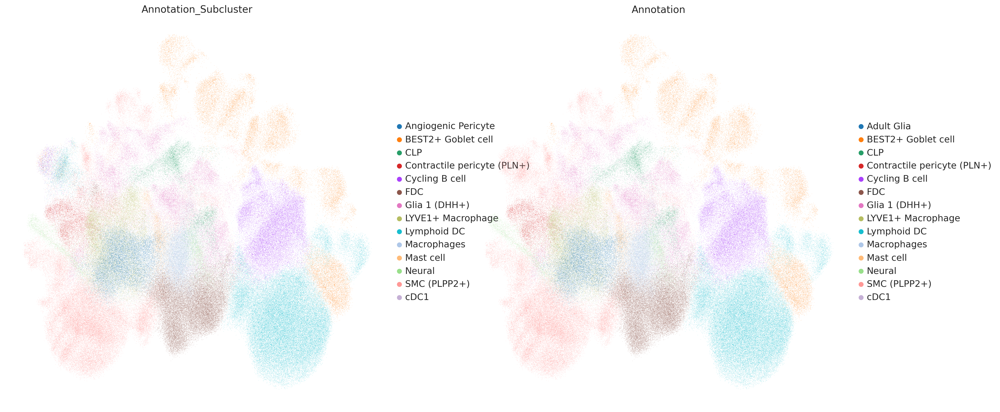

<Axes: title={'center': 'Annotation_Subcluster'}, xlabel='spatial1', ylabel='spatial2'>

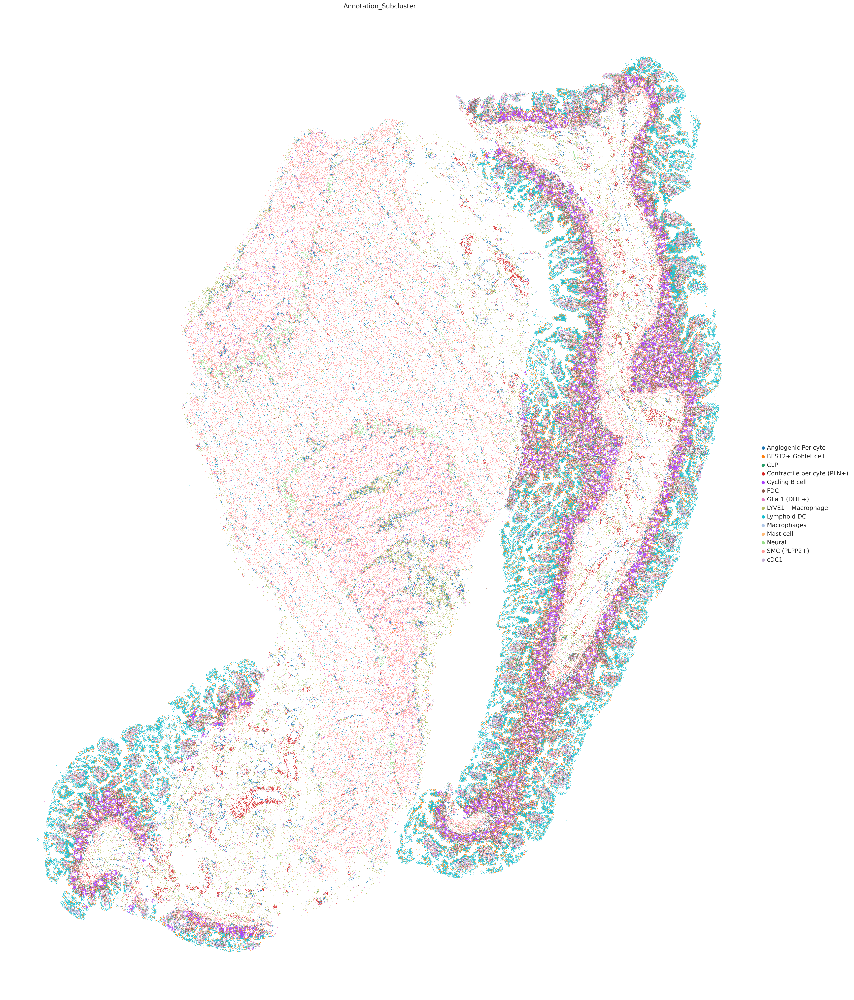

In [20]:
s.annotate_clusters(file_ann, col_cell_type="leiden", col_annotation="Annotation")
s.annotate_clusters(file_ann, col_cell_type="leiden_subcluster", col_annotation="Annotation_Subcluster")
s.plot_spatial(color="Annotation_Subcluster")

In [19]:
s.rna.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,Sample,Sample ID,Patient,Status,Project,Sample Location,Inflamed,Slide,GRID ID,Procedure Date,Age,Sex,Race,Hispanic,Diagnosis,Project.1,Procedure,Disease Status,Date Collected,Date Sectioned,Date of Hybridization,Storage in 4C,Created By,Created,Storage Status,Sample Location.1,Storage Row,Storage Col,Checked Out By,Stricture,Condition,file_path,n_counts,log_counts,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,log1p_total_counts,assay_protein,col_gene_symbols,col_cell_type,col_sample_id,col_batch,col_subject,col_condition,col_num_umis,col_segment,cell_filter_pmt,cell_filter_ncounts,cell_filter_ngene,gene_filter_ncell,gene_filter_ncounts,custom_thresholds,figsize,kws_scale,method_cluster,leiden,kws_pca,kws_umap,kws_neighbors,kws_cluster,resolution,genes_subset,leiden_subcluster,Annotation
0,aaaaibki-1,168,0,0,0,0,168.0,328.150481,13.908126,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,168.0,5.123964,93,93,4.543295,5.129899,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,22,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",22,SMC (PLPP2+)
1,aaaaiiji-1,166,0,0,0,0,166.0,107.607348,18.649532,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,166.0,5.111988,94,94,4.553877,5.117994,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,6,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",6,Macrophages
2,aaaajape-1,135,0,0,0,0,135.0,110.226410,10.250469,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,135.0,4.905275,77,77,4.356709,4.912655,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,4,"{'n_comps': None, 'use_highly_variable': False}",{'min_dist': 0.8},{},None,0.75,"['BEST2', 'ZG16', 'MUC4', 'KLK1', 'MUC5B', 'RE...",4,Angiogenic Pericyte
3,aaaamhbm-1,99,0,0,0,0,99.0,46.736720,16.482032,cell_boundaries,Uninflamed-50452A,50452A,50452,Available,scRNA & Spatial,Terminal Ileum,uninflamed,0010700,1011335,2023-12-04 00:00:00,69,female,white,NO,Crohn's Disease,Helmsley-Senescence,Resection,Active,nan,2024-01-22 15:25:38,2024-01-23 15:25:58,YES,ksenija sabic,2024-02-06 15:26:47.887000,Not in storage,nan,nan,nan,nan,None,Uninflamed,output-XETG00189__0010700__50452A-TUQ97N-EA__2...,99.0,4.595120,68,68,4.234107,4.605170,None,gene_symbols,leiden,Sample,Slide,Patient,None,None,region,None,"[50, None]","[30, None]","[3, None]","[3, None]",None,"(20, 20)",{},leiden,10,"{'n_comps': None, 'use_highly_variable': False}",{'min_dis

In [ ]:
pd.options.display.max_rows = 500

dff = pd.concat([pd.Series(marker_genes_dict[x]).to_frame("Marker")
                 for x in marker_genes_dict], keys=marker_genes_dict)
dff[dff.Marker.isin(self.rna.var_names)]

In [ ]:
# key_cell_type = [["Monocytes", "LYVE1+ Macrophage", "Macrophages", "CLP"],
#                  "BEST2+ Goblet cell"]
key_cell_type = None
for s in selves:
    ann = s.subcluster(key_cell_type=key_cell_type, copy=True,
                       kws_annotation=file_ann, col_cell_type="leiden",
                       col_annotation="Sub-Clustering", **kws_subcluster)
    s.rna = ann
    s.plot_spatial(color="Sub-Clustering")

In [ ]:
sc.pl.umap(adata, color="Annotation_subcluster")  # plot

In [ ]:
for i, s in enumerate(selves):
    _ = s.annotate_clusters(file_ann, col_cell_type="leiden",
                            col_annotation=col_cell_type,
                            out_file=out_files[i])  # annotate & write